# Analysis of Health Inspections across Prince George's County

Data Analysis carried out on data with over 35000 rows across various establishments in Prince George's County. Objective is to study the pattern of Inspections over time and gain insights.

In [1]:
#import the libraries we will use for this analysis
%pylab inline
import pandas as pd
import seaborn as sns
import datetime as dt

#for visuals
import plotly.offline as offline
import plotly.graph_objs as go

Populating the interactive namespace from numpy and matplotlib


# 1. Data Preparation and Cleansing

In [2]:
#load the data
df = pd.read_csv(r'C:\Users\vivek_000\Desktop\Python\HW7_Food Inspection.csv',  header = 0)
df.head()

,Establishment_id,Name,Category,Inspection_date,Inspection_results,City,State,Zip,Address_line_1,Address_line_2,...,Proper_sewage_disposal,No_bare_hand_contact,Adequate_hand_washing_facilities,Rodent_and_insects,Food_contact_surfaces_and_equipment,Inspection_type,Owner,Type,Location,Zip Codes
0,8176,LAUREL DUTCH MARKET - SAMMIE'S PRODUCE,Carry-out,09/05/2019 12:00:00 AM,Critical Violations observed,LAUREL,MD,20707.0,9701 FORT MEADE RD,------,...,In Compliance,In Compliance,In Compliance,In Compliance,In Compliance,Monitoring,Samuel Stoltzfus,Food Establishments,POINT (-76.838165 39.095491),15996.0
1,14622,JERSEY MIKE'S SUBS,Fast Food,09/06/2019 12:00:00 AM,Critical Violations observed,Riverdale,MD,20737.0,6761 45th ST,------,...,In Compliance,In Compliance,In Compliance,In Compliance,In Compliance,Re-inspection,DANIEL MALAMIS,Food Establishments,NaN,NaN
2,7273,ACCOKEEK ACADEMY,Public School,09/09/2019 12:00:00 AM,Non-Compliant - Violations Observed,ACCOKEEK,MD,20607.0,14400 BERRY RD,------,...,In Compliance,In Compliance,In Compliance,In Compliance,In Compliance,Comprehensive,MARK FOSSETT,Food Establishments,POINT (-76.980676 38.687531),8834.0
3,2103,PAPA JOHNS 728,Carry-out,09/05/2019 12:00:00 AM,Compliant - No Health Risk,BOWIE,MD,20715.0,6852 RACE TRACK RD,------,...,In Compliance,In Compliance,In Compliance,In Compliance,In Compliance,Re-inspection,Annie Berkovicz,Food Establishments,POINT (-76.729269 38.983881),16435.0
4,347,COLUMBIA PARK ELEMENTARY SCHOOL,Public School,09/05/2019 12:00:00 AM,Critical Violations observed,LANDOVER,MD,20785.0,1901 KENT VILLAGE DR,------,...,In Compliance,In Compliance,In Compliance,Out of Compliance,In Compliance,Comprehensive,MARK FOSSETT,Food Establishments,POINT (-76.88767 38.91584),31451.0


In [3]:
#create table of unique values
df_unique = pd.DataFrame(df['Category'].unique())
df_unique.head()

,0
0,Carry-out
1,Fast Food
2,Public School
3,Hotel
4,NaN


Categories that represent a restaurant are : 
'Carry-out', 'Fast Food', 'Hotel', 'Ice Cream', 'Bakery/Catering', 'Restaurant', 'Bar/Tavern/Lounge', 'Bakery', 'Coffee Shop', 'Cafeteria', 'Snack Bar/Concession Stand', 'Deli', 'Seafood', 'Fast Food - Chain', 'Full Service/Catering', 'Buffet', 'Pizza', 'Fast Food - Local', 'Diner', 'Donut', 'B & B'

In [4]:
#create a list of categories termed as restaurants
restaurant_list = ['Carry-out',
 'Fast Food',
 'Hotel',
 'Ice Cream',
 'Bakery/Catering',
 'Restaurant',
 'Bar/Tavern/Lounge',
 'Bakery',
 'Coffee Shop',
 'Cafeteria',
 'Snack Bar/Concession Stand',
 'Deli',
 'Seafood',
 'Fast Food - Chain',
 'Full Service/Catering',
 'Buffet',
 'Pizza',
 'Fast Food - Local',
 'Diner',
 'Donut',
 'B & B']
restaurant_list

['Carry-out',
 'Fast Food',
 'Hotel',
 'Ice Cream',
 'Bakery/Catering',
 'Restaurant',
 'Bar/Tavern/Lounge',
 'Bakery',
 'Coffee Shop',
 'Cafeteria',
 'Snack Bar/Concession Stand',
 'Deli',
 'Seafood',
 'Fast Food - Chain',
 'Full Service/Catering',
 'Buffet',
 'Pizza',
 'Fast Food - Local',
 'Diner',
 'Donut',
 'B & B']

In [5]:
#create dummy variable
df['Restaurant'] = df['Category'].apply(lambda x: 1 if x in restaurant_list else 0)
df['Restaurant'].head()

0    1
1    1
2    0
3    1
4    0
Name: Restaurant, dtype: int64

Date time operations

In [6]:
#check data type of col
df["Inspection_date"].apply(type).value_counts() #09/05/2019 12:00:00 AM

<class 'str'>    34736
Name: Inspection_date, dtype: int64

In [7]:
#convert to date time object with proper format
df["Inspection_date"] = pd.to_datetime(df["Inspection_date"], format = "%m/%d/%Y %I:%M:%S %p") 
df["Inspection_date"].head()

0   2019-09-05
1   2019-09-06
2   2019-09-09
3   2019-09-05
4   2019-09-05
Name: Inspection_date, dtype: datetime64[ns]

In [8]:
#check data type now
df["Inspection_date"].apply(type).value_counts() 

<class 'pandas._libs.tslibs.timestamps.Timestamp'>    34736
Name: Inspection_date, dtype: int64

In [9]:
#create a col for year
df["Inspection_year"] = df["Inspection_date"].apply(lambda x: x.year)
df["Inspection_year"].head()

0    2019
1    2019
2    2019
3    2019
4    2019
Name: Inspection_year, dtype: int64

In [10]:
#create a col for month
df["Inspection_month"] = df["Inspection_date"].apply(lambda x: x.month)
df["Inspection_month"].head()

0    9
1    9
2    9
3    9
4    9
Name: Inspection_month, dtype: int64

In [11]:
#create a col for year and month
#convert to string to combine cols
df["Inspection_year_month"] = df["Inspection_month"].astype(str) + " " + df["Inspection_year"].astype(str)
#convert to datetime obj
df["Inspection_year_month"] = pd.to_datetime(df["Inspection_year_month"], format='%m %Y')
df["Inspection_year_month"].head()

0   2019-09-01
1   2019-09-01
2   2019-09-01
3   2019-09-01
4   2019-09-01
Name: Inspection_year_month, dtype: datetime64[ns]

Creating dummy variables

In [12]:
#specify list of col names
violation_type=['Food_protected_from_contamination', 'Ill_workers_restricted', 'Proper_hand_washing', 'Cooling_time_and_temperature', 'Cold_holding_temperature', 'Hot_holding_temperature', 'Cooking_time_and_temperature', 'Reheating_time_and_temperature', 'Hot_and_cold_running_water_provided', 'Proper_sewage_disposal', 'No_bare_hand_contact', 'Adequate_hand_washing_facilities', 'Rodent_and_insects', 'Food_contact_surfaces_and_equipment']

In [13]:
#create dummy variables
df = pd.get_dummies(df, columns=violation_type, prefix=violation_type)
df.head()

,Establishment_id,Name,Category,Inspection_date,Inspection_results,City,State,Zip,Address_line_1,Address_line_2,...,Hot_and_cold_running_water_provided_In Compliance,Hot_and_cold_running_water_provided_Out of Compliance,Proper_sewage_disposal_In Compliance,Proper_sewage_disposal_Out of Compliance,No_bare_hand_contact_In Compliance,Adequate_hand_washing_facilities_In Compliance,Rodent_and_insects_In Compliance,Rodent_and_insects_Out of Compliance,Food_contact_surfaces_and_equipment_In Compliance,Food_contact_surfaces_and_equipment_Out of Compliance
0,8176,LAUREL DUTCH MARKET - SAMMIE'S PRODUCE,Carry-out,2019-09-05,Critical Violations observed,LAUREL,MD,20707.0,9701 FORT MEADE RD,------,...,1,0,1,0,1,1,1,0,1,0
1,14622,JERSEY MIKE'S SUBS,Fast Food,2019-09-06,Critical Violations observed,Riverdale,MD,20737.0,6761 45th ST,------,...,1,0,1,0,1,1,1,0,1,0
2,7273,ACCOKEEK ACADEMY,Public School,2019-09-09,Non-Compliant - Violations Observed,ACCOKEEK,MD,20607.0,14400 BERRY RD,------,...,1,0,1,0,1,1,1,0,1,0
3,2103,PAPA JOHNS 728,Carry-out,2019-09-05,Compliant - No Health Risk,BOWIE,MD,20715.0,6852 RACE TRACK RD,------,...,1,0,1,0,1,1,1,0,1,0
4,347,COLUMBIA PARK ELEMENTARY SCHOOL,Public School,2019-09-05,Critical Violations observed,LANDOVER,MD,20785.0,1901 KENT VILLAGE DR,------,...,1,0,1,0,1,1,0,1,1,0


In [14]:
df.columns #check col names

Index(['Establishment_id', 'Name', 'Category', 'Inspection_date',
       'Inspection_results', 'City', 'State', 'Zip', 'Address_line_1',
       'Address_line_2', 'Food_from_approved_source', 'Inspection_type',
       'Owner', 'Type', 'Location', 'Zip Codes', 'Restaurant',
       'Inspection_year', 'Inspection_month', 'Inspection_year_month',
       'Food_protected_from_contamination_In Compliance',
       'Food_protected_from_contamination_Out of Compliance',
       'Ill_workers_restricted_In Compliance',
       'Ill_workers_restricted_Out of Compliance',
       'Proper_hand_washing_In Compliance',
       'Proper_hand_washing_Out of Compliance',
       'Cooling_time_and_temperature_In Compliance',
       'Cooling_time_and_temperature_Out of Compliance',
       'Cold_holding_temperature_In Compliance',
       'Cold_holding_temperature_Out of Compliance',
       'Hot_holding_temperature_In Compliance',
       'Hot_holding_temperature_Out of Compliance',
       'Cooking_time_and_temperatu

Checking for violations

In [15]:
#create col to check for count of violations
df["No. of Violations"] = df.iloc[:,[21, 23, 25, 27, 29, 31, 33, 35, 37, 39, 43, 45]].sum(axis=1)
df["No. of Violations"].head()

0    1
1    1
2    0
3    0
4    2
Name: No. of Violations, dtype: int64

In [16]:
df.iloc[:,[21, 23, 25, 27, 29, 31, 33, 35, 37, 39, 43, 45]].head() #check indexed col names

,Food_protected_from_contamination_Out of Compliance,Ill_workers_restricted_Out of Compliance,Proper_hand_washing_Out of Compliance,Cooling_time_and_temperature_Out of Compliance,Cold_holding_temperature_Out of Compliance,Hot_holding_temperature_Out of Compliance,Cooking_time_and_temperature_Out of Compliance,Reheating_time_and_temperature_Out of Compliance,Hot_and_cold_running_water_provided_Out of Compliance,Proper_sewage_disposal_Out of Compliance,Rodent_and_insects_Out of Compliance,Food_contact_surfaces_and_equipment_Out of Compliance
0,1,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,1,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,1,0,0,0,0,0,1,0


In [17]:
#create col to check for atleast one violation
df['Violater'] = df['No. of Violations'].apply(lambda x: 0 if x==0 else 1)
df['Violater'].head()

0    1
1    1
2    0
3    0
4    1
Name: Violater, dtype: int64

In [18]:
#convert to wide format
df2 = df.pivot_table(columns='Inspection_date', index=['Establishment_id', 'Category', ], values='No. of Violations', aggfunc='sum', margins=True)
df2.head(20)

Inspection_date                     2011-07-01 00:00:00  2011-07-05 00:00:00  \
Establishment_id Category                                                      
1                Gas Station Store                  NaN                  NaN   
2                Carry-out                          NaN                  NaN   
                 Fast Food - Chain                  NaN                  NaN   
3                Full Service                       NaN                  NaN   
4                Full Service                       NaN                  NaN   
                 Restaurant                         NaN                  NaN   
5                Public School                      NaN                  NaN   
6                Public School                      NaN                  NaN   
7                Gas Station Store                  NaN                  NaN   
8                Restaurant                         NaN                  NaN   
10               Limited Service                    NaN                  NaN   
                 Specialty Store                    NaN                  NaN   
11               Carry-out                          NaN                  NaN   
12               Carry-out                          NaN                  NaN   
13               Full Service                       NaN                  NaN   
14               Carry-out                          NaN                  NaN   
15               Full Service                       NaN                  NaN   
                 Restaurant                         NaN                  NaN   
16               Carry-out                          NaN                  NaN   
18               Fast Food                          NaN                  NaN   

Inspection_date                     2011-07-06 00:00:00  2011-07-07 00:00:00  \
Establishment_id Category                                                      
1                Gas Station Store                  NaN                  NaN   
2                Carry-out                          NaN                  NaN   
                 Fast Food - Chain                  NaN                  NaN   
3                Full Service                       NaN                  NaN   
4                Full Service                       NaN                  NaN   
                 Restaurant                         NaN                  NaN   
5                Public School                      NaN                  NaN   
6                Public School                      NaN                  NaN   
7                Gas Station Store                  NaN                  NaN   
8                Restaurant                         NaN                  NaN   
10               Limited Service                    NaN                  NaN   
                 Specialty Store                    NaN                  NaN   
11               Carry-out                          NaN                  NaN   
12               Carry-out                          NaN                  NaN   
13               Full Service                       NaN                  NaN   
14               Carry-out                          NaN                  NaN   
15               Full Service                       NaN                  NaN   
                 Restaurant                         NaN                  NaN   
16               Carry-out                          NaN                  NaN   
18               Fast Food                          NaN                  NaN   

Inspection_date                     2011-07-08 00:00:00  2011-07-11 00:00:00  \
Establishment_id Category                                                      
1                Gas Station Store                  NaN                  NaN   
2                Carry-out                          NaN                  NaN   
                 Fast Food - Chain                  NaN                  NaN   
3                Full Service                       NaN                  NaN  

# 2.Statistics/Data Grouping

In [101]:
#convert to wide format
df2 = df.pivot_table(columns='Inspection_date', index=['Establishment_id', 'Category', ], values='No. of Violations', aggfunc='sum', margins=True)
df2.head(20)

Inspection_date                     2011-07-01 00:00:00  2011-07-05 00:00:00  \
Establishment_id Category                                                      
1                Gas Station Store                  NaN                  NaN   
2                Carry-out                          NaN                  NaN   
                 Fast Food - Chain                  NaN                  NaN   
3                Full Service                       NaN                  NaN   
4                Full Service                       NaN                  NaN   
                 Restaurant                         NaN                  NaN   
5                Public School                      NaN                  NaN   
6                Public School                      NaN                  NaN   
7                Gas Station Store                  NaN                  NaN   
8                Restaurant                         NaN                  NaN   
10               Limited Service                    NaN                  NaN   
                 Specialty Store                    NaN                  NaN   
11               Carry-out                          NaN                  NaN   
12               Carry-out                          NaN                  NaN   
13               Full Service                       NaN                  NaN   
14               Carry-out                          NaN                  NaN   
15               Full Service                       NaN                  NaN   
                 Restaurant                         NaN                  NaN   
16               Carry-out                          NaN                  NaN   
18               Fast Food                          NaN                  NaN   

Inspection_date                     2011-07-06 00:00:00  2011-07-07 00:00:00  \
Establishment_id Category                                                      
1                Gas Station Store                  NaN                  NaN   
2                Carry-out                          NaN                  NaN   
                 Fast Food - Chain                  NaN                  NaN   
3                Full Service                       NaN                  NaN   
4                Full Service                       NaN                  NaN   
                 Restaurant                         NaN                  NaN   
5                Public School                      NaN                  NaN   
6                Public School                      NaN                  NaN   
7                Gas Station Store                  NaN                  NaN   
8                Restaurant                         NaN                  NaN   
10               Limited Service                    NaN                  NaN   
                 Specialty Store                    NaN                  NaN   
11               Carry-out                          NaN                  NaN   
12               Carry-out                          NaN                  NaN   
13               Full Service                       NaN                  NaN   
14               Carry-out                          NaN                  NaN   
15               Full Service                       NaN                  NaN   
                 Restaurant                         NaN                  NaN   
16               Carry-out                          NaN                  NaN   
18               Fast Food                          NaN                  NaN   

Inspection_date                     2011-07-08 00:00:00  2011-07-11 00:00:00  \
Establishment_id Category                                                      
1                Gas Station Store                  NaN                  NaN   
2                Carry-out                          NaN                  NaN   
                 Fast Food - Chain                  NaN                  NaN   
3                Full Service                       NaN                  NaN  

In [102]:
#filter only restaurants
df3 = df[df["Restaurant"]==1]
df3.head()

,Establishment_id,Name,Category,Inspection_date,Inspection_results,City,State,Zip,Address_line_1,Address_line_2,...,Proper_sewage_disposal_In Compliance,Proper_sewage_disposal_Out of Compliance,No_bare_hand_contact_In Compliance,Adequate_hand_washing_facilities_In Compliance,Rodent_and_insects_In Compliance,Rodent_and_insects_Out of Compliance,Food_contact_surfaces_and_equipment_In Compliance,Food_contact_surfaces_and_equipment_Out of Compliance,No. of Violations,Violater
0,8176,LAUREL DUTCH MARKET - SAMMIE'S PRODUCE,Carry-out,2019-09-05,Critical Violations observed,LAUREL,MD,20707.0,9701 FORT MEADE RD,------,...,1,0,1,1,1,0,1,0,1,1
1,14622,JERSEY MIKE'S SUBS,Fast Food,2019-09-06,Critical Violations observed,Riverdale,MD,20737.0,6761 45th ST,------,...,1,0,1,1,1,0,1,0,1,1
3,2103,PAPA JOHNS 728,Carry-out,2019-09-05,Compliant - No Health Risk,BOWIE,MD,20715.0,6852 RACE TRACK RD,------,...,1,0,1,1,1,0,1,0,0,0
5,272,CHECKERS DRIVE THRU RESTAURANT,Carry-out,2019-09-10,Compliance Schedule - Outstanding,COLLEGE PARK,MD,20740.0,6051 GREENBELT RD,------,...,1,0,1,1,1,0,1,0,0,0
6,1453,SUBWAY,Fast Food,2019-09-09,Compliance Schedule - Outstanding,LARGO,MD,20774.0,10428 CAMPUS WAY,------,...,1,0,1,1,1,0,0,1,1,1


In [103]:
#compute a series 
s2 = df3.iloc[:,[21, 23, 25, 27, 29, 31, 33, 35, 37, 39, 43, 45]].sum()

In [104]:
#create a table
violation_df = pd.DataFrame(s2, columns = ['No. of Violations'])
#sort values
violation_df.sort_values('No. of Violations', ascending=False)

,No. of Violations
Cold_holding_temperature_Out of Compliance,3431
Food_contact_surfaces_and_equipment_Out of Compliance,3292
Rodent_and_insects_Out of Compliance,2704
Hot_holding_temperature_Out of Compliance,1516
Proper_hand_washing_Out of Compliance,698
Food_protected_from_contamination_Out of Compliance,627
Cooling_time_and_temperature_Out of Compliance,174
Hot_and_cold_running_water_provided_Out of Compliance,117
Cooking_time_and_temperature_Out of Compliance,72
Reheating_time_and_temperature_Out of Compliance,66


Cold_holding_temperature_Out of Compliance is the most common violation - violated on 6725 inspections

# 3.Data Visualisation

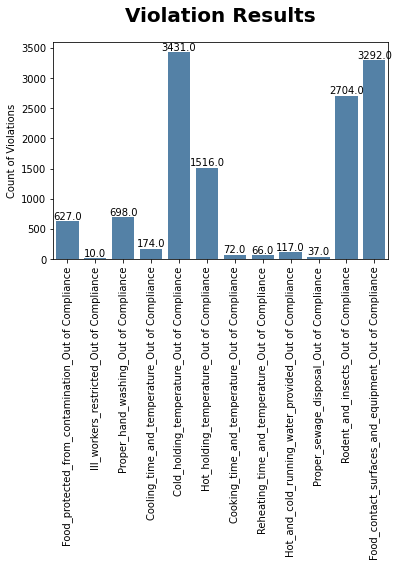

In [106]:
#barplot violation results
axis = sns.barplot(x=violation_df.index, y=violation_df['No. of Violations'], palette=['steelblue'])
axis.set_title('Violation Results', fontdict={'fontsize': 20, 'fontweight': 700, 'color': 'black'}, pad=20)
plt.ylabel('Count of Violations')
plt.xticks(rotation='vertical')

for p in axis.patches:
    height = p.get_height()
    axis.annotate('{}'.format(height),xy=(p.get_x() + p.get_width() / 2, height), ha='center', va='bottom')

Change over time

In [107]:
#create dataframe with only violaters
df7 = df3[df3["No. of Violations"]>=1]

In [108]:
#get no. of inspections
ser1 = df7.groupby(by='Establishment_id')["Inspection_date"].count()

In [109]:
#get no. of violations
ser2 = df7.groupby(by='Establishment_id')["No. of Violations"].sum()

In [110]:
#get inspection year & month
ser3 = df7.groupby(by='Establishment_id')["Inspection_year_month"].last()

In [111]:
#create a dataframe
df8 = pd.concat([ser1, ser2, ser3], axis=1)

In [112]:
#rename the column
df8.rename(columns={'Inspection_date': 'No. of Inspections'}, inplace=True)

In [113]:
#compute total inspections
mysum = df8['No. of Inspections'].sum()
mysum

7561

In [114]:
#compute % of inspections
df8['Percentage of Inspections'] = (df8['No. of Inspections']/mysum)*100

In [115]:
#set index
df8.set_index("Inspection_year_month", drop=True, inplace=True) 
df8.head() #view index

,No. of Inspections,No. of Violations,Percentage of Inspections
Inspection_year_month,,,
2017-02-01,9,12,0.119032
2020-03-01,2,2,0.026452
2013-06-01,5,12,0.066129
2016-07-01,9,15,0.119032
2016-01-01,7,11,0.092580


Text(0.5, 1.0, 'Inspections over Time')

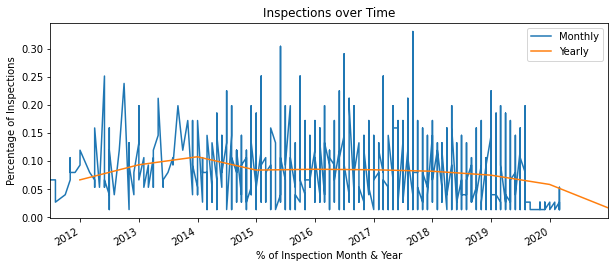

In [116]:
#plot line graph over time
df8['Percentage of Inspections'].plot(figsize=(10,4))
#sampled over every year, mean of year taken and put at the end interval
df8['Percentage of Inspections'].resample('A').mean().plot() 
#add legends, labels
plt.legend(('Monthly','Yearly'))
plt.ylabel('Percentage of Inspections')  
plt.xlabel('% of Inspection Month & Year')
plt.title("Inspections over Time")

From the plot, we can observe that the % of Inspections can be seen to decrease over the years starting from 2014. However, there was an intital increase prior to this from 2012 to 2014. Overall, the number of inspections are reducing over time.
But to see if inspections are actually getting easier over time, let us plot no. of violations over time.

Text(0.5, 1.0, 'No. of Violations over Time')

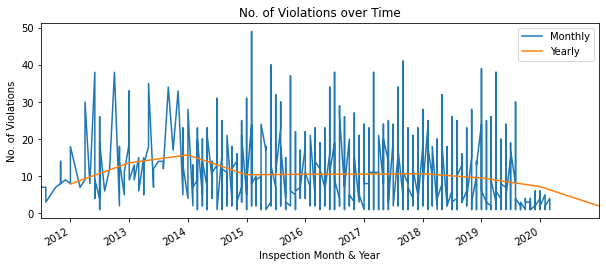

In [117]:
#plot line graph over time
df8['No. of Violations'].plot(figsize=(10,4))
#sampled over every year, mean of year taken and put at the end interval
df8['No. of Violations'].resample('A').mean().plot() 
#add legends, labels
plt.legend(('Monthly','Yearly'))
plt.ylabel('No. of Violations')  
plt.xlabel('Inspection Month & Year')
plt.title("No. of Violations over Time")

From the above two plots, we can conclude that not only are the no. of inspections decreasing over time,  the no. of violations are also decreasing over time. Hemce, inspections are getting easier over time.

map visual

In [131]:
# Enter my mapbox token
mapbox_access_token = 'pk.eyJ1Ijoidml2ZWtzaGl2NjY3IiwiYSI6ImNrOWhxZjNyeDExZzkzZW8yNWM0OXA4NngifQ.1xSvSozpeA-5lfyuzV71mA'

In [132]:
df3['Location'].apply(type).value_counts() #29 values are missing - NaN

<class 'str'>      16374
<class 'float'>       29
Name: Location, dtype: int64

In [133]:
#view string values
df3['Location'].head()

0    POINT (-76.838165 39.095491)
1                             NaN
3    POINT (-76.729269 38.983881)
5    POINT (-76.910024 38.997563)
6    POINT (-76.822919 38.895049)
Name: Location, dtype: object

In [134]:
df10=df3.copy(deep=True) #create a deep copy

In [135]:
# remove unwanted stuff
df10['Location'] = df3['Location'].str.replace("\APOINT\s?\(","")
df10['Location'].head()

0    -76.838165 39.095491)
1                      NaN
3    -76.729269 38.983881)
5    -76.910024 38.997563)
6    -76.822919 38.895049)
Name: Location, dtype: object

In [136]:
# remove unwanted stuff
df10['Location']=df10['Location'].str.replace(")","")
df10['Location'].head()

0    -76.838165 39.095491
1                     NaN
3    -76.729269 38.983881
5    -76.910024 38.997563
6    -76.822919 38.895049
Name: Location, dtype: object

In [137]:
df10['Longitude'] = df10['Location'].str.split(expand=True)[0] #set longitude
df10['Latitude'] = df10['Location'].str.split(expand=True)[1] #set latitude

In [138]:
#view longitude col
df10['Longitude'].head()

0    -76.838165
1           NaN
3    -76.729269
5    -76.910024
6    -76.822919
Name: Longitude, dtype: object

In [139]:
#view latitude col
df10['Latitude'].head()

0    39.095491
1          NaN
3    38.983881
5    38.997563
6    38.895049
Name: Latitude, dtype: object

In [140]:
#Form dataframes based on violation
df5 = df10[df10['Violater']==1]
df6 = df10[df10['Violater']==0]

In [141]:
class_map_data =[ go.Scattermapbox(
        lon = df5['Longitude'],
        lat = df5['Latitude'],
        text = df5['Name'],
        hoverinfo='text',
        customdata = df5,
        mode = 'markers',
        name='Violater',
        marker = dict(
                    color = 'red',
                    symbol = 'circle',
                    opacity = .5,
            size=8)
),
                 go.Scattermapbox(
        lon = df6['Longitude'],
        lat = df6['Latitude'],
        text = df6['Name'],
        hoverinfo='text',
        customdata = df6,
        mode = 'markers',
        name='Non-Violater',
        marker = dict(
                    color = 'orange',
                    symbol = 'circle',
                    opacity = .5,
            size=8)
)]

class_map_layout = go.Layout( autosize=True,
        title = 'Restaurant Locations',
        mapbox=go.layout.Mapbox(
            accesstoken=mapbox_access_token,
            zoom=1
        )
    )

class_map = go.Figure(data=class_map_data, layout=class_map_layout)
class_map.show()

Clusters of red are present all across the map. Some specific areas like Laurel have certain violations (in red). This can be better visualised by zooming into the area/cluster of interest.

Some violaters here are GRANDE BUFFET & GRILL, HOOTERS OF LAUREL & LAUREL'S HOUSE OF HORROR among others.
These restaurants had some common violation types. Let's find this out by manual inspection

In [142]:
#create list of names
names = ["GRANDE BUFFET & GRILL", "HOOTERS OF LAUREL", "LAUREL'S HOUSE OF HORROR"]
#create new dataframe with these restaurants only
df7 = df5[df5.Name.str.contains('|'.join(names))]

In [143]:
#view out of compliance cols to observe trends
df7.iloc[:,[1,21, 23, 25, 27, 29, 31, 33, 35, 37, 39, 43, 45]]

,Name,Food_protected_from_contamination_Out of Compliance,Ill_workers_restricted_Out of Compliance,Proper_hand_washing_Out of Compliance,Cooling_time_and_temperature_Out of Compliance,Cold_holding_temperature_Out of Compliance,Hot_holding_temperature_Out of Compliance,Cooking_time_and_temperature_Out of Compliance,Reheating_time_and_temperature_Out of Compliance,Hot_and_cold_running_water_provided_Out of Compliance,Proper_sewage_disposal_Out of Compliance,Rodent_and_insects_Out of Compliance,Food_contact_surfaces_and_equipment_Out of Compliance
1122,GRANDE BUFFET & GRILL,0,0,0,0,1,0,0,0,0,0,1,1
1258,GRANDE BUFFET & GRILL,0,0,0,0,0,0,0,0,0,0,0,1
1438,HOOTERS OF LAUREL,0,0,0,0,0,0,0,0,0,0,0,1
33372,LAUREL'S HOUSE OF HORROR,0,0,1,0,0,0,0,0,0,1,0,0


A common compliance issue among these cluster of restaurants in the Laurel area are:
Food_contact_surfaces_and_equipment_Out of Compliance